In [3]:
import psycopg2


In [4]:



print("Packages installed successfully!")
# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")
except Exception as e:
    print("Error: Unable to connect to the database:", e)


Connection established successfully!


In [40]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy
import seaborn as sns

print("Packages installed successfully!")


Packages installed successfully!


In [41]:
# query to fetch data
query = "SELECT * FROM xdr_data;"
cursor = connection.cursor()
cursor.execute(query)

# Fetch the data into a DataFrame
columns = [desc[0] for desc in cursor.description]
data = cursor.fetchall()
df = pd.DataFrame(data, columns=columns)

# Check for missing values
missing_values = df.isnull().sum()
print("Missing values per column:\n", missing_values)


# Get column names from the whole table
try:
    cursor = connection.cursor()
    cursor.execute("SELECT column_name FROM information_schema.columns WHERE table_name = 'your_table_name';")
    columns = cursor.fetchall()
    print("Columns from the whole table:")
    for column in columns:
        print(column[0])
except Exception as e:
    print("Error fetching column names:", e)
finally:
    cursor.close()

# Close connection
connection.close()

Missing values per column:
 Bearer Id                                      991
Start                                            1
Start ms                                         1
End                                              1
End ms                                           1
Dur. (ms)                                        1
IMSI                                           570
MSISDN/Number                                 1066
IMEI                                           572
Last Location Name                            1153
Avg RTT DL (ms)                              27829
Avg RTT UL (ms)                              27812
Avg Bearer TP DL (kbps)                          1
Avg Bearer TP UL (kbps)                          1
TCP DL Retrans. Vol (Bytes)                  88146
TCP UL Retrans. Vol (Bytes)                  96649
DL TP < 50 Kbps (%)                            754
50 Kbps < DL TP < 250 Kbps (%)                 754
250 Kbps < DL TP < 1 Mbps (%)                  754
DL 

In [ ]:
import pandas as pd
# query to fetch data
query = "SELECT * FROM xdr_data;"
cursor = connection.cursor()
cursor.execute(query)

# Fetch the data into a DataFrame
columns = [desc[0] for desc in cursor.description]
data = cursor.fetchall()
select_df = pd.DataFrame(data, columns=columns)
# Display data types of each column
print(select_df.dtypes)


In [8]:
select_df.dtypes

Unique values in column 'Bearer Id': [1.31144835e+19 1.31144835e+19 1.31144835e+19 ... 7.27782567e+18
 7.34988326e+18 1.31144836e+19]
Unique values in column 'Start': ['4/4/2019 12:01' '4/9/2019 13:04' '4/9/2019 17:42' ... '4/29/2019 7:27'
 '4/29/2019 7:28' None]
Unique values in column 'Start ms': [770. 235.   1. ... 431.  95.  nan]
Unique values in column 'End': ['4/25/2019 14:35' '4/25/2019 8:15' '4/25/2019 11:58' ...
 '4/30/2019 23:18' '4/30/2019 22:32' None]
Unique values in column 'End ms': [662. 606. 652. ...  91. 499.  nan]
Unique values in column 'Dur. (ms)': [1823652. 1365104. 1361762. ...   81230.   98249.      nan]
Unique values in column 'IMSI': [2.08201448e+14 2.08201909e+14 2.08200314e+14 ... 2.08202201e+14
 2.08201711e+14 2.08202101e+14]
Unique values in column 'MSISDN/Number': [3.36649622e+10 3.36818544e+10 3.37606271e+10 ... 3.36506887e+10
 3.36218901e+10 3.36196221e+10]
Unique values in column 'IMEI': [3.55212095e+13 3.57940090e+13 3.52815104e+13 ... 3.54831095e+13
 

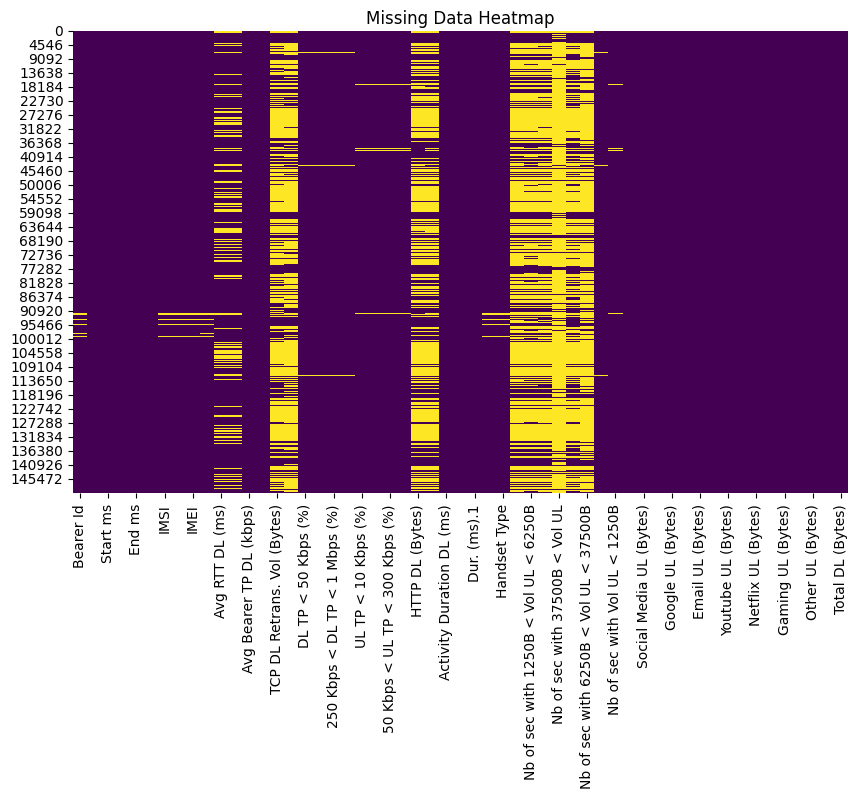

In [35]:
# Visualization: Missing Data Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Data Heatmap')
plt.show()

# Close cursor and connection
cursor.close()
connection.close()

In [49]:

# Get column names from the whole table
try:
    cursor = connection.cursor()
    cursor.execute("SELECT column_name FROM information_schema.columns WHERE table_name = 'your_table_name';")
    columns = cursor.fetchall()
    print("Columns from the whole table:")
    for column in columns:
        print(column[0])
except Exception as e:
    print("Error fetching column names:", e)
finally:
    cursor.close()

# Close connection
connection.close()

Error fetching column names: connection already closed


In [52]:

import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Get column names from the whole table
    try:
        cursor = connection.cursor()
        cursor.execute("SELECT column_name FROM information_schema.columns WHERE table_name = 'xdr_data' AND column_name = 'Handset Manufacturer';")
        columns = cursor.fetchall()
        if len(columns) > 0:
            print("Column found:", columns[0][0])
        else:
            print("Column not found.")
    except Exception as e:
        print("Error fetching column names:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()




Connection established successfully!
Column found: Handset Manufacturer


In [53]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve top 3 manufacturers
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Handset Manufacturer", COUNT(*) AS manufacturer_count
            FROM xdr_data
            GROUP BY "Handset Manufacturer"
            ORDER BY manufacturer_count DESC
            LIMIT 3;
        """)
        top_manufacturers = cursor.fetchall()
        print("Top 3 manufacturers:")
        for index, manufacturer in enumerate(top_manufacturers, start=1):
            print(f"{index}. {manufacturer[0]}: {manufacturer[1]}")
    except Exception as e:
        print("Error fetching top manufacturers:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
Top 3 manufacturers:
1. Apple: 59565
2. Samsung: 40839
3. Huawei: 34423


In [51]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Get column names from the whole table
    try:
        cursor = connection.cursor()
        cursor.execute("SELECT column_name FROM information_schema.columns WHERE table_name = 'xdr_data';")
        columns = cursor.fetchall()
        print("Columns from the whole table:")
        for column in columns:
            print(column[0])
    except Exception as e:
        print("Error fetching column names:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
Columns from the whole table:
Bearer Id
Start
Start ms
End
End ms
Dur. (ms)
IMSI
MSISDN/Number
IMEI
Last Location Name
Avg RTT DL (ms)
Avg RTT UL (ms)
Avg Bearer TP DL (kbps)
Avg Bearer TP UL (kbps)
TCP DL Retrans. Vol (Bytes)
TCP UL Retrans. Vol (Bytes)
DL TP < 50 Kbps (%)
50 Kbps < DL TP < 250 Kbps (%)
250 Kbps < DL TP < 1 Mbps (%)
DL TP > 1 Mbps (%)
UL TP < 10 Kbps (%)
10 Kbps < UL TP < 50 Kbps (%)
50 Kbps < UL TP < 300 Kbps (%)
UL TP > 300 Kbps (%)
HTTP DL (Bytes)
HTTP UL (Bytes)
Activity Duration DL (ms)
Activity Duration UL (ms)
Dur. (ms).1
Handset Manufacturer
Handset Type
Nb of sec with 125000B < Vol DL
Nb of sec with 1250B < Vol UL < 6250B
Nb of sec with 31250B < Vol DL < 125000B
Nb of sec with 37500B < Vol UL
Nb of sec with 6250B < Vol DL < 31250B
Nb of sec with 6250B < Vol UL < 37500B
Nb of sec with Vol DL < 6250B
Nb of sec with Vol UL < 1250B
Social Media DL (Bytes)
Social Media UL (Bytes)
Google DL (Bytes)
Google UL (Bytes)
Email DL (By

In [54]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve the column "Handset Type"
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT column_name
            FROM information_schema.columns
            WHERE table_name = 'xdr_data' AND column_name = 'Handset Type';
        """)
        column = cursor.fetchone()
        if column:
            print(f"Column 'Handset Type' found in the table 'xdr_data'.")
        else:
            print("Column 'Handset Type' not found in the table 'xdr_data'.")
    except Exception as e:
        print("Error fetching column:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
Column 'Handset Type' found in the table 'xdr_data'.


In [55]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve the top 10 handset types
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Handset Type", COUNT(*) AS handset_count
            FROM xdr_data
            GROUP BY "Handset Type"
            ORDER BY handset_count DESC
            LIMIT 10;
        """)
        top_handset_types = cursor.fetchall()
        print("Top 10 handset types:")
        for index, handset_type in enumerate(top_handset_types, start=1):
            print(f"{index}. {handset_type[0]}: {handset_type[1]}")
    except Exception as e:
        print("Error fetching top handset types:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
Top 10 handset types:
1. Huawei B528S-23A: 19752
2. Apple iPhone 6S (A1688): 9419
3. Apple iPhone 6 (A1586): 9023
4. undefined: 8987
5. Apple iPhone 7 (A1778): 6326
6. Apple iPhone Se (A1723): 5187
7. Apple iPhone 8 (A1905): 4993
8. Apple iPhone Xr (A2105): 4568
9. Samsung Galaxy S8 (Sm-G950F): 4520
10. Apple iPhone X (A1901): 3813


Connection established successfully!


/tmp/ipykernel_4660/679754660.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')


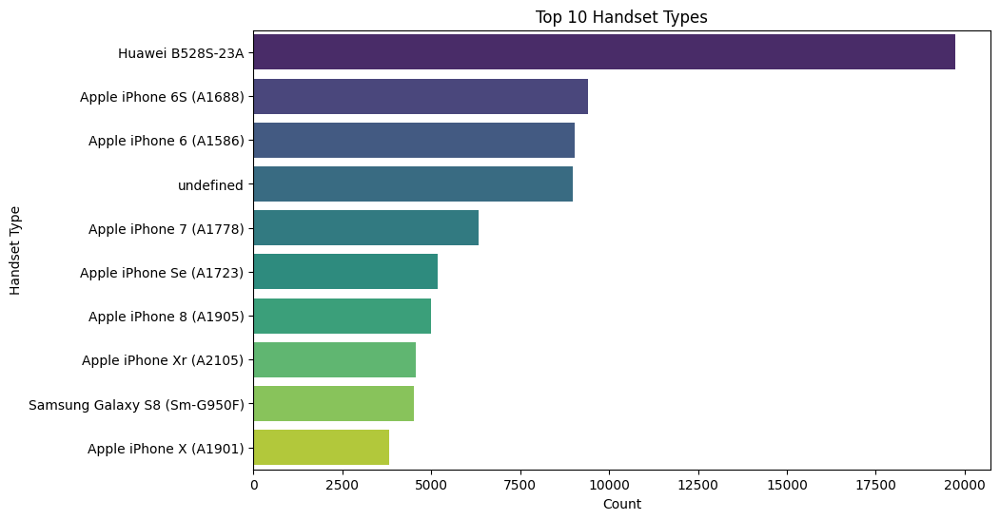

Summary statistics:
              Count
count     10.000000
mean    7658.800000
std     4739.396066
min     3813.000000
25%     4674.250000
50%     5756.500000
75%     9014.000000
max    19752.000000

Top handset types:
              Handset Type  Count
0         Huawei B528S-23A  19752
1  Apple iPhone 6S (A1688)   9419
2   Apple iPhone 6 (A1586)   9023
3                undefined   8987
4   Apple iPhone 7 (A1778)   6326


In [58]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve the top 10 handset types
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Handset Type", COUNT(*) AS handset_count
            FROM xdr_data
            GROUP BY "Handset Type"
            ORDER BY handset_count DESC
            LIMIT 10;
        """)
        top_handset_types = cursor.fetchall()

        # Convert data to DataFrame for visualization
        df = pd.DataFrame(top_handset_types, columns=['Handset Type', 'Count'])

        # Plot bar chart
        plt.figure(figsize=(10, 6))
        sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')
        plt.title('Top 10 Handset Types')
        plt.xlabel('Count')
        plt.ylabel('Handset Type')
        plt.show()

        # Additional EDA
        print("Summary statistics:")
        print(df.describe())
        print("\nTop handset types:")
        print(df.head())

    except Exception as e:
        print("Error fetching top handset types:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


In [56]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve the top 3 handset manufacturers
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Handset Manufacturer", COUNT(*) AS manufacturer_count
            FROM xdr_data
            GROUP BY "Handset Manufacturer"
            ORDER BY manufacturer_count DESC
            LIMIT 3;
        """)
        top_manufacturers = cursor.fetchall()

        # For each top manufacturer, retrieve the top 5 handsets
        for manufacturer in top_manufacturers:
            print(f"Top 5 handsets for {manufacturer[0]}:")
            cursor.execute("""
                SELECT "Handset Type", COUNT(*) AS handset_count
                FROM xdr_data
                WHERE "Handset Manufacturer" = %s
                GROUP BY "Handset Type"
                ORDER BY handset_count DESC
                LIMIT 5;
            """, (manufacturer[0],))
            top_handsets = cursor.fetchall()
            for index, handset in enumerate(top_handsets, start=1):
                print(f"{index}. {handset[0]}: {handset[1]}")
            print()  # Print an empty line between each manufacturer's results

    except Exception as e:
        print("Error fetching top manufacturers and handsets:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
Top 5 handsets for Apple:
1. Apple iPhone 6S (A1688): 9419
2. Apple iPhone 6 (A1586): 9023
3. Apple iPhone 7 (A1778): 6326
4. Apple iPhone Se (A1723): 5187
5. Apple iPhone 8 (A1905): 4993

Top 5 handsets for Samsung:
1. Samsung Galaxy S8 (Sm-G950F): 4520
2. Samsung Galaxy A5 Sm-A520F: 3724
3. Samsung Galaxy J5 (Sm-J530): 3696
4. Samsung Galaxy J3 (Sm-J330): 3484
5. Samsung Galaxy S7 (Sm-G930X): 3199

Top 5 handsets for Huawei:
1. Huawei B528S-23A: 19752
2. Huawei E5180: 2079
3. Huawei P20 Lite Huawei Nova 3E: 2021
4. Huawei P20: 1480
5. Huawei Y6 2018: 997



Connection established successfully!
Top 5 handsets for Apple:


/tmp/ipykernel_4660/2403118104.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')


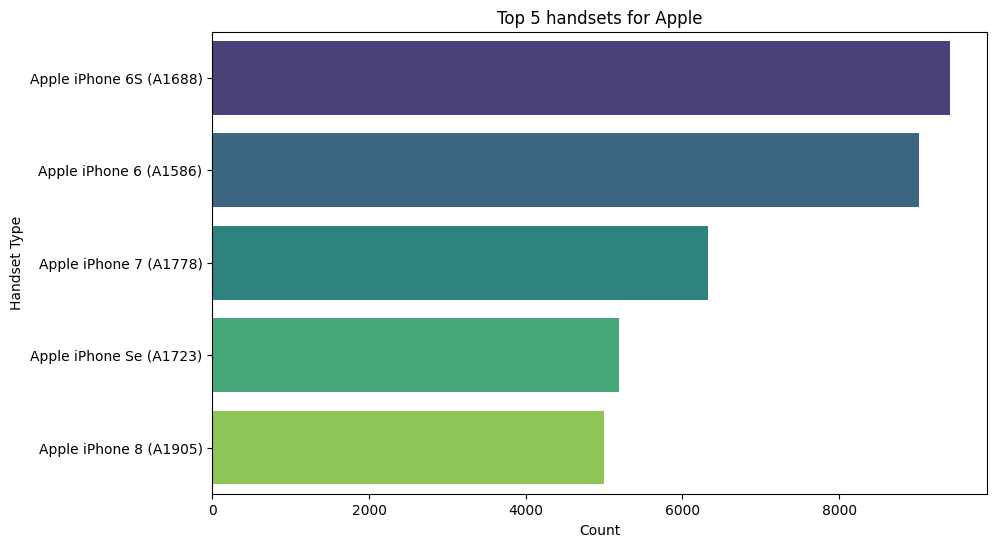

Top 5 handsets for Samsung:


/tmp/ipykernel_4660/2403118104.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')


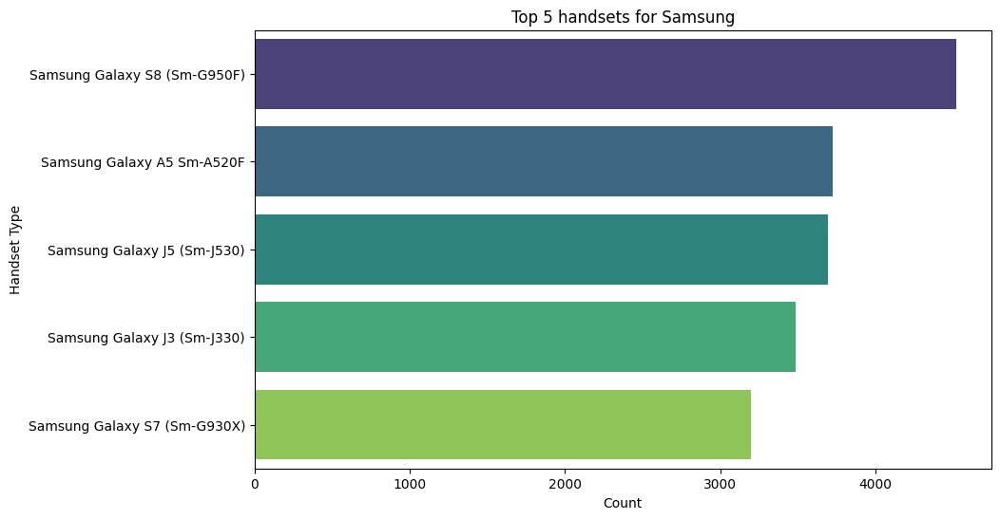

Top 5 handsets for Huawei:


/tmp/ipykernel_4660/2403118104.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')


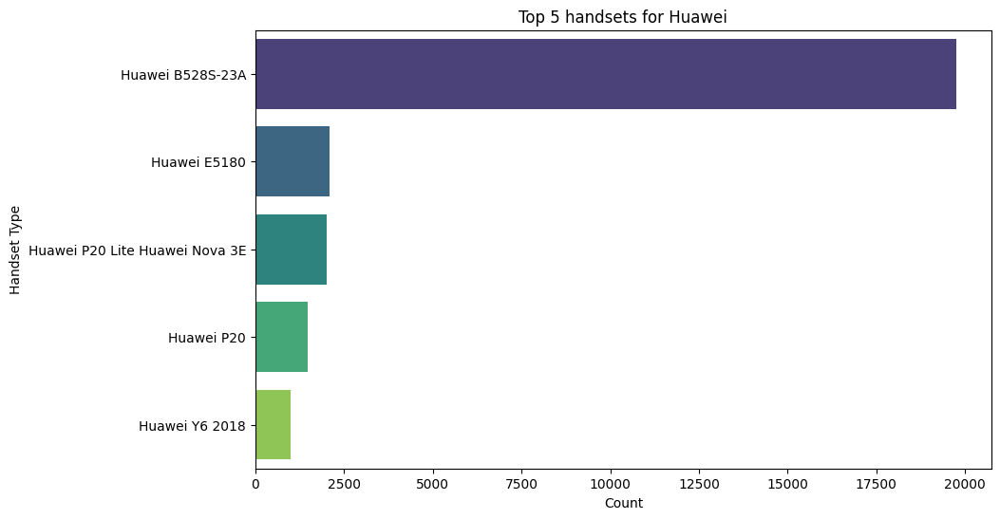

In [57]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

# Establish a connection
try:
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Retrieve the top 3 handset manufacturers
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Handset Manufacturer", COUNT(*) AS manufacturer_count
            FROM xdr_data
            GROUP BY "Handset Manufacturer"
            ORDER BY manufacturer_count DESC
            LIMIT 3;
        """)
        top_manufacturers = cursor.fetchall()

        # For each top manufacturer, retrieve the top 5 handsets
        for manufacturer in top_manufacturers:
            print(f"Top 5 handsets for {manufacturer[0]}:")
            cursor.execute("""
                SELECT "Handset Type", COUNT(*) AS handset_count
                FROM xdr_data
                WHERE "Handset Manufacturer" = %s
                GROUP BY "Handset Type"
                ORDER BY handset_count DESC
                LIMIT 5;
            """, (manufacturer[0],))
            top_handsets = cursor.fetchall()

            # Convert data to DataFrame for visualization
            df = pd.DataFrame(top_handsets, columns=['Handset Type', 'Count'])

            # Bar plot
            plt.figure(figsize=(10, 6))
            sns.barplot(x='Count', y='Handset Type', data=df, palette='viridis')
            plt.title(f"Top 5 handsets for {manufacturer[0]}")
            plt.xlabel('Count')
            plt.ylabel('Handset Type')
            plt.show()

    except Exception as e:
        print("Error fetching top manufacturers and handsets:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


In [61]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                SUM("Total UL (Bytes)") AS total_ul_sessions,
                SUM("Total DL (Bytes)") AS total_dl_sessions
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)

        # Fetch and print the results
        rows = cursor.fetchall()
        for row in rows:
            print(row)

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()




Connection established successfully!
(33601001722.0, 36053108.0, 842637466.0)
(33601001754.0, 36104459.0, 120755184.0)
(33601002511.0, 39306820.0, 556659663.0)
(33601007832.0, 20327526.0, 401993172.0)
(33601008617.0, 94280527.0, 1363130417.0)
(33601010682.0, 60009249.0, 555207972.0)
(33601011634.0, 101681858.0, 553041208.0)
(33601011959.0, 38575279.0, 294085078.0)
(33601014694.0, 93572016.0, 896560173.0)
(33601020306.0, 47091008.0, 685372753.0)
(33601021045.0, 35502671.0, 79473365.0)
(33601021217.0, 48882819.0, 581209615.0)
(33601022743.0, 55651065.0, 426768017.0)
(33601024291.0, 50643116.0, 308268784.0)
(33601025738.0, 44980549.0, 185343847.0)
(33601026147.0, 24173758.0, 517606208.0)
(33601027208.0, 35589503.0, 661970164.0)
(33601031129.0, 40923152.0, 596129923.0)
(33601032846.0, 31967475.0, 686484941.0)
(33601032987.0, 46285839.0, 600917876.0)
(33601034530.0, 81019849.0, 1551740796.0)
(33601034784.0, 86263137.0, 1036599478.0)
(33601035197.0, 35349417.0, 383642405.0)
(33601036379.0, 2

Connection established successfully!
Summary statistics:
            user_id  total_ul_sessions  total_dl_sessions
count  1.068560e+05       1.068570e+05       1.068570e+05
mean   4.511474e+10       5.772370e+07       6.382035e+08
std    2.889423e+12       1.400375e+08       1.558474e+09
min    3.360100e+10       2.866892e+06       8.827082e+06
25%    3.365088e+10       3.639554e+07       3.148302e+08
50%    3.366365e+10       4.679434e+07       5.703713e+08
75%    3.368344e+10       6.573376e+07       8.073701e+08
max    8.823971e+14       4.432530e+10       4.869236e+11


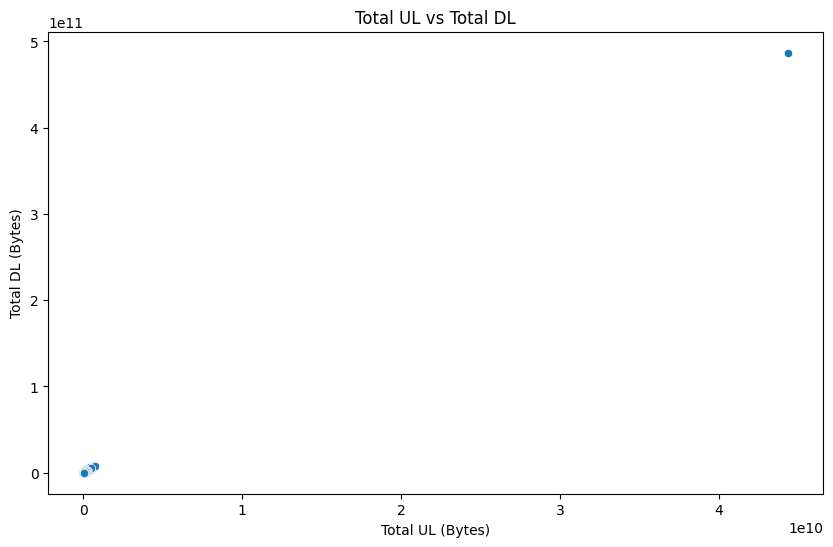

In [62]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                SUM("Total UL (Bytes)") AS total_ul_sessions,
                SUM("Total DL (Bytes)") AS total_dl_sessions
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)
        
        # Fetch the results into a pandas DataFrame
        df = pd.DataFrame(cursor.fetchall(), columns=['user_id', 'total_ul_sessions', 'total_dl_sessions'])

        # Perform EDA
        print("Summary statistics:")
        print(df.describe())

        # Plotting
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x='total_ul_sessions', y='total_dl_sessions', data=df)
        plt.title('Total UL vs Total DL')
        plt.xlabel('Total UL (Bytes)')
        plt.ylabel('Total DL (Bytes)')
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!


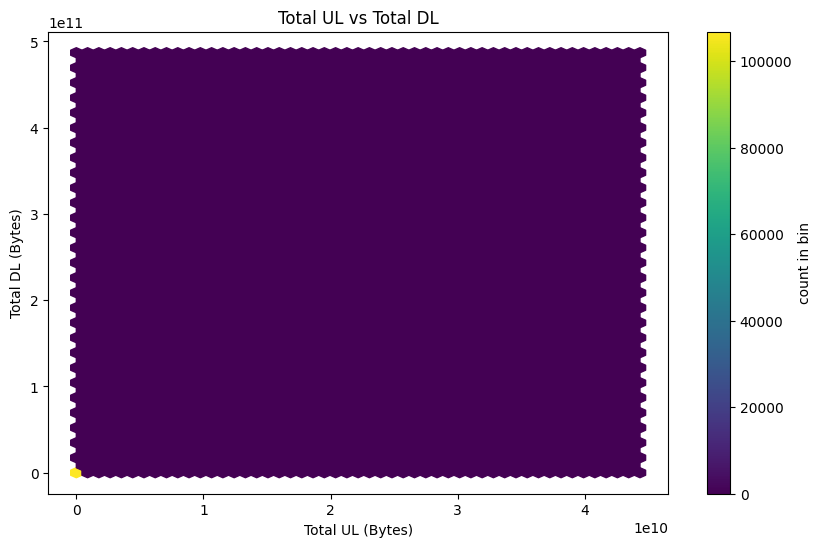

In [63]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                SUM("Total UL (Bytes)") AS total_ul_sessions,
                SUM("Total DL (Bytes)") AS total_dl_sessions
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)
        
        # Fetch the results into a pandas DataFrame
        df = pd.DataFrame(cursor.fetchall(), columns=['user_id', 'total_ul_sessions', 'total_dl_sessions'])

        # Plotting
        plt.figure(figsize=(10, 6))
        plt.hexbin(df['total_ul_sessions'], df['total_dl_sessions'], gridsize=50, cmap='viridis')
        plt.colorbar(label='count in bin')
        plt.title('Total UL vs Total DL')
        plt.xlabel('Total UL (Bytes)')
        plt.ylabel('Total DL (Bytes)')
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


In [64]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                COUNT(*) AS num_xdr_sessions,
                SUM("Social Media UL (Bytes)" + "Social Media DL (Bytes)" +
                    "Google UL (Bytes)" + "Google DL (Bytes)" +
                    "Email UL (Bytes)" + "Email DL (Bytes)" +
                    "Youtube UL (Bytes)" + "Youtube DL (Bytes)" +
                    "Netflix UL (Bytes)" + "Netflix DL (Bytes)" +
                    "Gaming UL (Bytes)" + "Gaming DL (Bytes)" +
                    "Other UL (Bytes)" + "Other DL (Bytes)") AS total_session_duration
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)

        # Fetch and print the results
        rows = cursor.fetchall()
        for row in rows:
            print(row)

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
(33601001722.0, 1, 1255787564.0)
(33601001754.0, 1, 436417344.0)
(33601002511.0, 1, 1091052984.0)
(33601007832.0, 1, 447568699.0)
(33601008617.0, 2, 2235054657.0)
(33601010682.0, 2, 1095575829.0)
(33601011634.0, 2, 859918491.0)
(33601011959.0, 1, 510773383.0)
(33601014694.0, 2, 2016653584.0)
(33601020306.0, 1, 866204929.0)
(33601021045.0, 1, 655673245.0)
(33601021217.0, 1, 1225128536.0)
(33601022743.0, 1, 1000329050.0)
(33601024291.0, 1, 1187242601.0)
(33601025738.0, 1, 620352267.0)
(33601026147.0, 1, 1046241951.0)
(33601027208.0, 1, 1287861088.0)
(33601031129.0, 1, 1375967932.0)
(33601032846.0, 1, 1493655132.0)
(33601032987.0, 1, 1205049788.0)
(33601034530.0, 2, 3156542175.0)
(33601034784.0, 2, 2714127130.0)
(33601035197.0, 1, 1111041074.0)
(33601036379.0, 1, 934016586.0)
(33601037966.0, 1, 1223679121.0)
(33601041557.0, 1, 1033569745.0)
(33601044885.0, 1, 1219877741.0)
(33601044963.0, 1, 416677592.0)
(33601047438.0, 1, 749466161.0)
(33601048751.0, 

Connection established successfully!
Summary statistics:
            user_id  num_xdr_sessions  total_session_duration
count  1.068560e+05     106857.000000            1.068570e+05
mean   4.511474e+10          1.403755            1.287054e+09
std    2.889423e+12          3.355032            3.091025e+09
min    3.360100e+10          1.000000            5.836229e+07
25%    3.365088e+10          1.000000            7.704872e+08
50%    3.366365e+10          1.000000            1.077408e+09
75%    3.368344e+10          2.000000            1.511679e+09
max    8.823971e+14       1066.000000            9.736730e+11


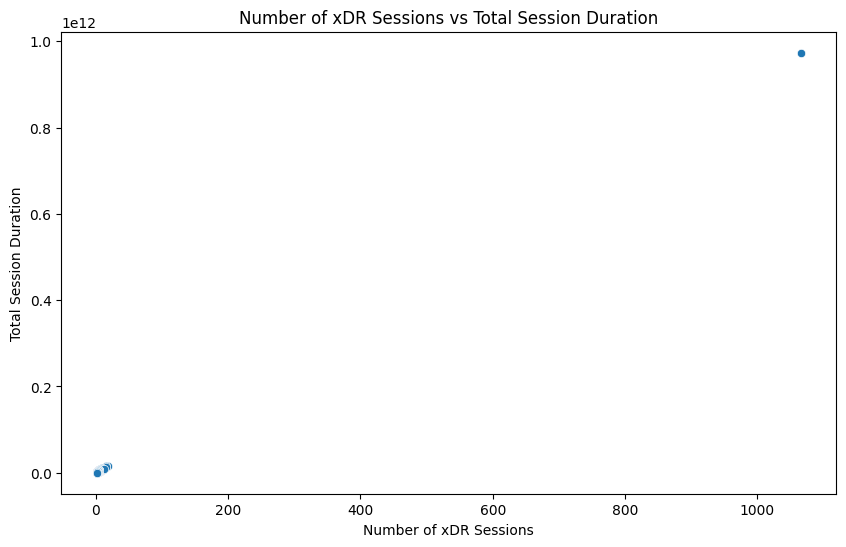

In [65]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                COUNT(*) AS num_xdr_sessions,
                SUM("Social Media UL (Bytes)" + "Social Media DL (Bytes)" +
                    "Google UL (Bytes)" + "Google DL (Bytes)" +
                    "Email UL (Bytes)" + "Email DL (Bytes)" +
                    "Youtube UL (Bytes)" + "Youtube DL (Bytes)" +
                    "Netflix UL (Bytes)" + "Netflix DL (Bytes)" +
                    "Gaming UL (Bytes)" + "Gaming DL (Bytes)" +
                    "Other UL (Bytes)" + "Other DL (Bytes)") AS total_session_duration
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)
        
        # Fetch the results into a pandas DataFrame
        df = pd.DataFrame(cursor.fetchall(), columns=['user_id', 'num_xdr_sessions', 'total_session_duration'])

        # Perform EDA
        print("Summary statistics:")
        print(df.describe())

        # Plotting
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x='num_xdr_sessions', y='total_session_duration', data=df)
        plt.title('Number of xDR Sessions vs Total Session Duration')
        plt.xlabel('Number of xDR Sessions')
        plt.ylabel('Total Session Duration')
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!


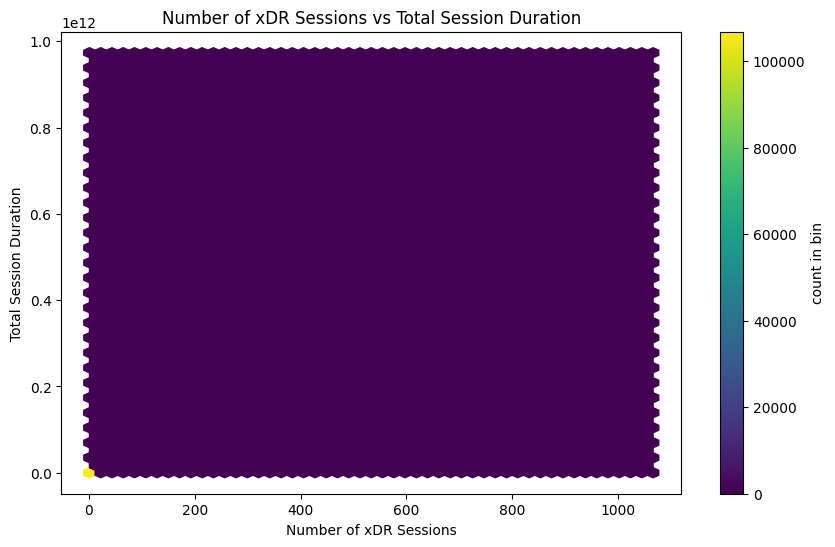

In [66]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                COUNT(*) AS num_xdr_sessions,
                SUM("Social Media UL (Bytes)" + "Social Media DL (Bytes)" +
                    "Google UL (Bytes)" + "Google DL (Bytes)" +
                    "Email UL (Bytes)" + "Email DL (Bytes)" +
                    "Youtube UL (Bytes)" + "Youtube DL (Bytes)" +
                    "Netflix UL (Bytes)" + "Netflix DL (Bytes)" +
                    "Gaming UL (Bytes)" + "Gaming DL (Bytes)" +
                    "Other UL (Bytes)" + "Other DL (Bytes)") AS total_session_duration
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number";
        """)
        
        # Fetch the results into a pandas DataFrame
        df = pd.DataFrame(cursor.fetchall(), columns=['user_id', 'num_xdr_sessions', 'total_session_duration'])

        # Plotting
        plt.figure(figsize=(10, 6))
        plt.hexbin(df['num_xdr_sessions'], df['total_session_duration'], gridsize=50, cmap='viridis')
        plt.colorbar(label='count in bin')
        plt.title('Number of xDR Sessions vs Total Session Duration')
        plt.xlabel('Number of xDR Sessions')
        plt.ylabel('Total Session Duration')
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


In [67]:
import psycopg2

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                "Bearer Id" AS bearer_id,
                SUM("Social Media UL (Bytes)" + "Social Media DL (Bytes)") AS social_media_data_volume,
                SUM("Google UL (Bytes)" + "Google DL (Bytes)") AS google_data_volume,
                SUM("Email UL (Bytes)" + "Email DL (Bytes)") AS email_data_volume,
                SUM("Youtube UL (Bytes)" + "Youtube DL (Bytes)") AS youtube_data_volume,
                SUM("Netflix UL (Bytes)" + "Netflix DL (Bytes)") AS netflix_data_volume,
                SUM("Gaming UL (Bytes)" + "Gaming DL (Bytes)") AS gaming_data_volume,
                SUM("Other UL (Bytes)" + "Other DL (Bytes)") AS other_data_volume
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number", "Bearer Id";
        """)

        # Fetch and print the results
        rows = cursor.fetchall()
        for row in rows:
            print(row)

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
(33601001722.0, 1.31144835547628e+19, 2232135.0, 4389005.0, 1331362.0, 21624548.0, 27180981.0, 812458661.0, 386570872.0)
(33601001754.0, 7.34988326078609e+18, 2660565.0, 5334863.0, 3307781.0, 12432223.0, 11221763.0, 119750078.0, 281710071.0)
(33601002511.0, 7.34988326338868e+18, 3195623.0, 3443126.0, 3205380.0, 21333570.0, 19353900.0, 538827713.0, 501693672.0)
(33601007832.0, 1.30424259727811e+19, 280294.0, 9678493.0, 2284670.0, 6977321.0, 1942092.0, 391126127.0, 35279702.0)
(33601008617.0, 7.27782565584034e+18, 1524057.0, 10170635.0, 1413685.0, 20492482.0, 21973110.0, 802565189.0, 85988660.0)
(33601008617.0, 7.34988324987858e+18, 1388485.0, 8328981.0, 1891784.0, 21040520.0, 27228614.0, 512232631.0, 718815824.0)
(33601010682.0, 7.2778256570575e+18, 993654.0, 2417450.0, 4035810.0, 27958396.0, 21735594.0, 126130650.0, 212253545.0)
(33601010682.0, 7.34988325109545e+18, 2799258.0, 12845684.0, 3812786.0, 6388726.0, 8579907.0, 385505137.0, 280119232.0)
(3

Connection established successfully!


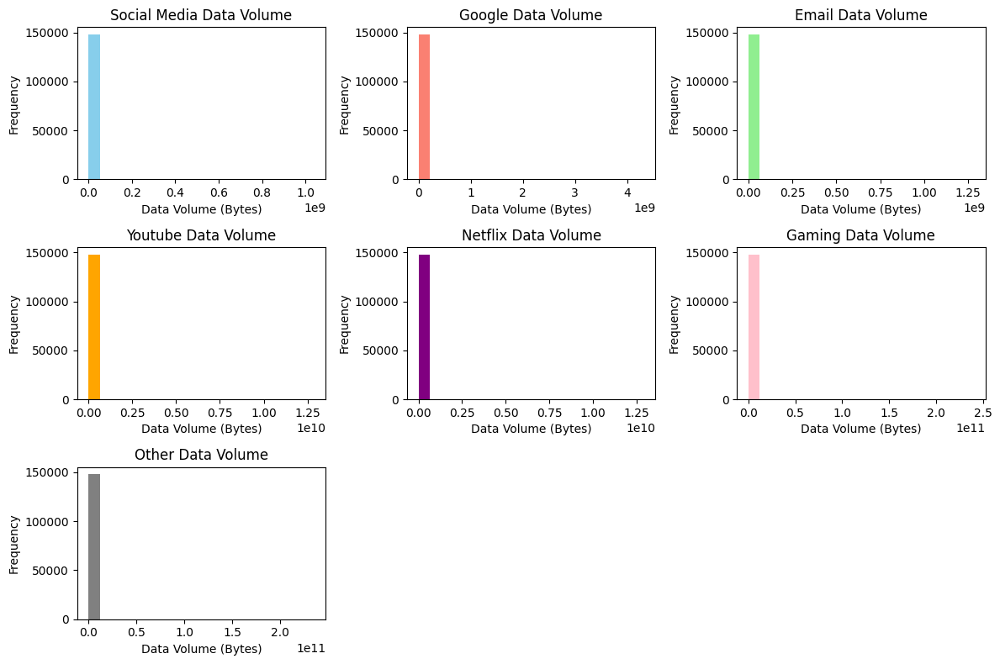

In [68]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT
                "MSISDN/Number" AS user_id,
                "Bearer Id" AS bearer_id,
                SUM("Social Media UL (Bytes)" + "Social Media DL (Bytes)") AS social_media_data_volume,
                SUM("Google UL (Bytes)" + "Google DL (Bytes)") AS google_data_volume,
                SUM("Email UL (Bytes)" + "Email DL (Bytes)") AS email_data_volume,
                SUM("Youtube UL (Bytes)" + "Youtube DL (Bytes)") AS youtube_data_volume,
                SUM("Netflix UL (Bytes)" + "Netflix DL (Bytes)") AS netflix_data_volume,
                SUM("Gaming UL (Bytes)" + "Gaming DL (Bytes)") AS gaming_data_volume,
                SUM("Other UL (Bytes)" + "Other DL (Bytes)") AS other_data_volume
            FROM
                xdr_data
            GROUP BY
                "MSISDN/Number", "Bearer Id";
        """)

        # Fetch the results into a pandas DataFrame
        df = pd.DataFrame(cursor.fetchall(), columns=['user_id', 'bearer_id', 
                                                       'social_media_data_volume', 'google_data_volume',
                                                       'email_data_volume', 'youtube_data_volume',
                                                       'netflix_data_volume', 'gaming_data_volume',
                                                       'other_data_volume'])

        # Plotting
        plt.figure(figsize=(12, 8))

        # Social Media data volume
        plt.subplot(3, 3, 1)
        plt.hist(df['social_media_data_volume'], bins=20, color='skyblue')
        plt.title('Social Media Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Google data volume
        plt.subplot(3, 3, 2)
        plt.hist(df['google_data_volume'], bins=20, color='salmon')
        plt.title('Google Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Email data volume
        plt.subplot(3, 3, 3)
        plt.hist(df['email_data_volume'], bins=20, color='lightgreen')
        plt.title('Email Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Youtube data volume
        plt.subplot(3, 3, 4)
        plt.hist(df['youtube_data_volume'], bins=20, color='orange')
        plt.title('Youtube Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Netflix data volume
        plt.subplot(3, 3, 5)
        plt.hist(df['netflix_data_volume'], bins=20, color='purple')
        plt.title('Netflix Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Gaming data volume
        plt.subplot(3, 3, 6)
        plt.hist(df['gaming_data_volume'], bins=20, color='pink')
        plt.title('Gaming Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        # Other data volume
        plt.subplot(3, 3, 7)
        plt.hist(df['other_data_volume'], bins=20, color='gray')
        plt.title('Other Data Volume')
        plt.xlabel('Data Volume (Bytes)')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


In [71]:
import psycopg2
import pandas as pd

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query to fetch user sessions data
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "MSISDN/Number", "Start", "End", "Total UL (Bytes)", "Total DL (Bytes)"
            FROM xdr_data; -- Replace 'your_table_name' with the actual table name
        """)
        
        # Fetch the results into a pandas DataFrame
        columns = [desc[0] for desc in cursor.description]
        data = cursor.fetchall()
        df = pd.DataFrame(data, columns=columns)

        # Convert 'Start' and 'End' columns to datetime objects
        df['Start'] = pd.to_datetime(df['Start'], format='%m/%d/%Y %H:%M')
        df['End'] = pd.to_datetime(df['End'], format='%m/%d/%Y %H:%M')

        # Calculate session duration (in seconds)
        df['Session Duration'] = (df['End'] - df['Start']).dt.total_seconds()

        # Calculate total traffic (UL + DL) for each session
        df['Total Traffic'] = df['Total UL (Bytes)'] + df['Total DL (Bytes)']

        # Calculate session frequency for each user
        session_frequency = df.groupby('MSISDN/Number').size().reset_index(name='Session Frequency')

        # Aggregate session duration and total traffic for each user
        user_engagement = df.groupby('MSISDN/Number').agg({'Session Duration': 'sum', 'Total Traffic': 'sum'}).reset_index()

        # Merge session frequency with user engagement data
        user_engagement = pd.merge(user_engagement, session_frequency, on='MSISDN/Number', how='left')

        # Display the resulting DataFrame
        print(user_engagement)

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
        MSISDN/Number  Session Duration  Total Traffic  Session Frequency
0        3.360100e+10          116760.0   8.786906e+08                  1
1        3.360100e+10          181260.0   1.568596e+08                  1
2        3.360100e+10          135000.0   5.959665e+08                  1
3        3.360101e+10           49920.0   4.223207e+08                  1
4        3.360101e+10           37200.0   1.457411e+09                  2
...               ...               ...            ...                ...
106851   3.379000e+10            8760.0   7.146416e+08                  1
106852   3.379000e+10          141000.0   4.803073e+08                  1
106853   3.197021e+12          877380.0   2.321240e+08                  1
106854   3.370000e+14          253020.0   5.962878e+08                  1
106855   8.823971e+14          869820.0   1.391536e+08                  1

[106856 rows x 4 columns]


Connection established successfully!


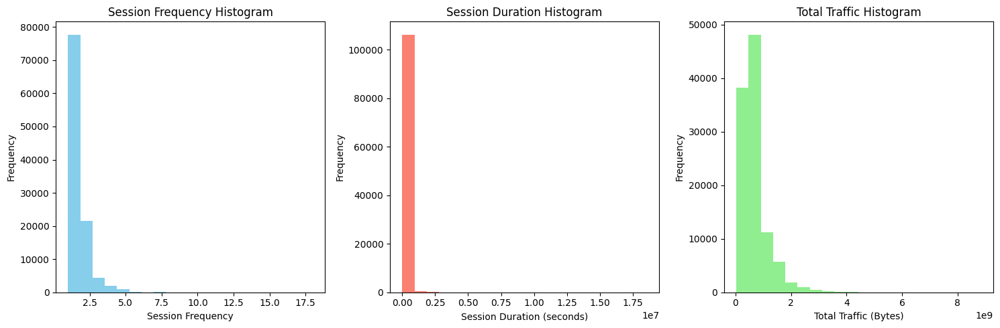

In [74]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query to fetch user sessions data
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "MSISDN/Number", "Start", "End", "Total UL (Bytes)", "Total DL (Bytes)"
            FROM xdr_data; -- Replace 'your_table_name' with the actual table name
        """)
        
        # Fetch the results into a pandas DataFrame
        columns = [desc[0] for desc in cursor.description]
        data = cursor.fetchall()
        df = pd.DataFrame(data, columns=columns)

        # Convert 'Start' and 'End' columns to datetime objects
        df['Start'] = pd.to_datetime(df['Start'], format='%m/%d/%Y %H:%M')
        df['End'] = pd.to_datetime(df['End'], format='%m/%d/%Y %H:%M')

        # Calculate session duration (in seconds)
        df['Session Duration'] = (df['End'] - df['Start']).dt.total_seconds()

        # Calculate total traffic (UL + DL) for each session
        df['Total Traffic'] = df['Total UL (Bytes)'] + df['Total DL (Bytes)']

        # Calculate session frequency for each user
        session_frequency = df.groupby('MSISDN/Number').size().reset_index(name='Session Frequency')

        # Aggregate session duration and total traffic for each user
        user_engagement = df.groupby('MSISDN/Number').agg({'Session Duration': 'sum', 'Total Traffic': 'sum'}).reset_index()

        # Merge session frequency with user engagement data
        user_engagement = pd.merge(user_engagement, session_frequency, on='MSISDN/Number', how='left')

        # Plotting histograms
        plt.figure(figsize=(15, 5))

        # Plot session frequency histogram
        plt.subplot(1, 3, 1)
        plt.hist(user_engagement['Session Frequency'], bins=20, color='skyblue')
        plt.title('Session Frequency Histogram')
        plt.xlabel('Session Frequency')
        plt.ylabel('Frequency')

        # Plot session duration histogram
        plt.subplot(1, 3, 2)
        plt.hist(user_engagement['Session Duration'], bins=20, color='salmon')
        plt.title('Session Duration Histogram')
        plt.xlabel('Session Duration (seconds)')
        plt.ylabel('Frequency')

        # Plot total traffic histogram
        plt.subplot(1, 3, 3)
        plt.hist(user_engagement['Total Traffic'], bins=20, color='lightgreen')
        plt.title('Total Traffic Histogram')
        plt.xlabel('Total Traffic (Bytes)')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()


Connection established successfully!
        MSISDN/Number  Avg TCP Retransmission  Avg RTT  \
0        3.360100e+10            2.571697e+07    23.00   
1        3.360100e+10            2.571697e+07    15.50   
2        3.360100e+10            2.571697e+07      NaN   
3        3.360101e+10            2.571697e+07    42.00   
4        3.360101e+10            2.571697e+07    29.75   
...               ...                     ...      ...   
106851   3.379000e+10            2.571697e+07    26.00   
106852   3.379000e+10            2.571697e+07    20.00   
106853   3.197021e+12            2.571697e+07      NaN   
106854   3.370000e+14            2.571697e+07      NaN   
106855   8.823971e+14            2.571697e+07      NaN   

                            Handset Type  Avg Throughput  
0         Huawei P20 Lite Huawei Nova 3E            38.0  
1                 Apple iPhone 7 (A1778)            49.5  
2                              undefined            48.5  
3                Apple iPhone 

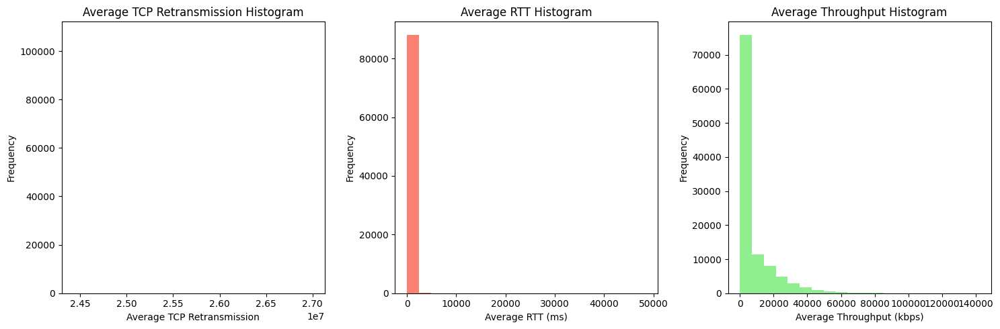

In [77]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt
# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'




try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query to fetch user sessions data
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "MSISDN/Number", 
                   "Avg RTT DL (ms)", 
                   "Avg RTT UL (ms)",
                   "TCP DL Retrans. Vol (Bytes)",
                   "TCP UL Retrans. Vol (Bytes)",
                   "Avg Bearer TP DL (kbps)",
                   "Avg Bearer TP UL (kbps)",
                   "Handset Type"
            FROM xdr_data; -- Replace 'your_table_name' with the actual table name
        """)
        
        # Fetch the results into a pandas DataFrame
        columns = [desc[0] for desc in cursor.description]
        data = cursor.fetchall()
        df = pd.DataFrame(data, columns=columns)

        # Treat missing values and outliers
        df['Avg RTT'] = (df['Avg RTT DL (ms)'] + df['Avg RTT UL (ms)']) / 2
        df['TCP Retransmission'] = df['TCP DL Retrans. Vol (Bytes)'] + df['TCP UL Retrans. Vol (Bytes)']
        df['Avg TCP Retransmission'] = df['TCP Retransmission'].mean()
        df['Avg Throughput'] = (df['Avg Bearer TP DL (kbps)'] + df['Avg Bearer TP UL (kbps)']) / 2
        df['Handset Type'].fillna(df['Handset Type'].mode()[0], inplace=True)

        # Aggregate per customer
        aggregated_data = df.groupby('MSISDN/Number').agg({
            'Avg TCP Retransmission': 'mean',
            'Avg RTT': 'mean',
            'Handset Type': lambda x: x.mode().iloc[0],
            'Avg Throughput': 'mean'
        }).reset_index()

        # Display the resulting DataFrame
        print(aggregated_data)

        # Plotting histograms
        plt.figure(figsize=(15, 5))

        # Plotting histogram for average TCP retransmission
        plt.subplot(1, 3, 1)
        plt.hist(aggregated_data['Avg TCP Retransmission'], bins=20, color='skyblue')
        plt.title('Average TCP Retransmission Histogram')
        plt.xlabel('Average TCP Retransmission')
        plt.ylabel('Frequency')

        # Plotting histogram for average RTT
        plt.subplot(1, 3, 2)
        plt.hist(aggregated_data['Avg RTT'], bins=20, color='salmon')
        plt.title('Average RTT Histogram')
        plt.xlabel('Average RTT (ms)')
        plt.ylabel('Frequency')

        # Plotting histogram for average throughput
        plt.subplot(1, 3, 3)
        plt.hist(aggregated_data['Avg Throughput'], bins=20, color='lightgreen')
        plt.title('Average Throughput Histogram')
        plt.xlabel('Average Throughput (kbps)')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()



Connection established successfully!
Top 10 TCP Values:
34645     4.344116e+09
140813    4.301477e+09
77982     4.294432e+09
135678    4.291465e+09
3782      4.288121e+09
119677    4.275492e+09
39637     4.268647e+09
59016     4.261616e+09
76993     4.260174e+09
41209     4.254660e+09
Name: TCP Values, dtype: float64

Bottom 10 TCP Values:
143594     86.0
111106     97.0
18432     106.0
13157     108.0
97069     113.0
8816      128.0
99958     129.0
83230     134.0
95965     134.0
12866     143.0
Name: TCP Values, dtype: float64

Most Frequent TCP Values:
TCP Values
2660.0     29
5320.0     24
6650.0     20
3990.0     19
7980.0     14
1873.0     13
2648.0      9
15960.0     9
2385.0      8
10640.0     8
Name: count, dtype: int64

Top 10 RTT Values:
30166     48462.0
29927     32320.5
17910     27906.0
5989      27424.0
22851     13639.0
23455     13150.0
1373      12961.0
81277     12857.5
97320     12694.0
100582    12369.0
Name: Avg RTT, dtype: float64

Bottom 10 RTT Values:
42612   

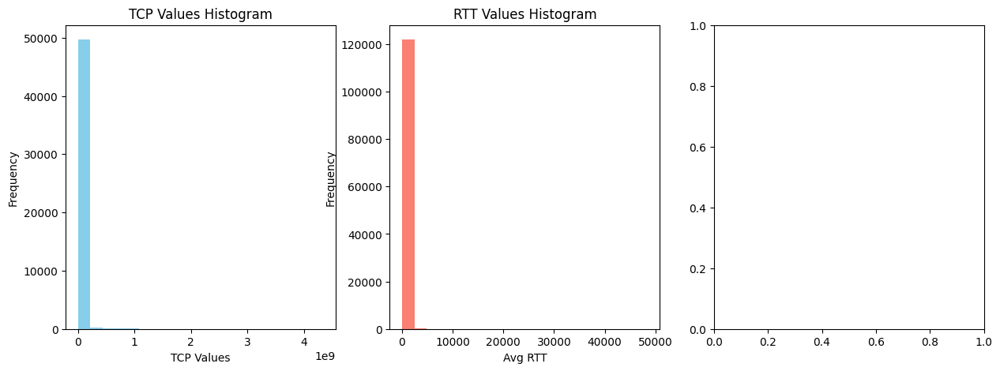

In [80]:
import psycopg2
import pandas as pd
import matplotlib.pyplot as plt

# Connection parameters
dbname = 'postgres'
user = 'postgres'
password = 'postgres'
host = 'localhost'
port = '5432'

try:
    # Establish a connection
    connection = psycopg2.connect(dbname=dbname, user=user, password=password, host=host, port=port)
    print("Connection established successfully!")

    # Execute the SQL query to fetch data
    try:
        cursor = connection.cursor()
        cursor.execute("""
            SELECT "Avg RTT DL (ms)", "Avg RTT UL (ms)",
                   "TCP DL Retrans. Vol (Bytes)", "TCP UL Retrans. Vol (Bytes)",
                   "Avg Bearer TP DL (kbps)", "Avg Bearer TP UL (kbps)"
            FROM xdr_data; -- Replace 'your_table_name' with the actual table name
        """)
        
        # Fetch the results into a pandas DataFrame
        columns = [desc[0] for desc in cursor.description]
        data = cursor.fetchall()
        df = pd.DataFrame(data, columns=columns)

        # Calculate Avg RTT
        df['Avg RTT'] = (df['Avg RTT DL (ms)'] + df['Avg RTT UL (ms)']) / 2

        # Calculate TCP values
        df['TCP Values'] = df['TCP DL Retrans. Vol (Bytes)'] + df['TCP UL Retrans. Vol (Bytes)']

        # Calculate Throughput values
        df['Throughput Values'] = (df['Avg Bearer TP DL (kbps)'] + df['Avg Bearer TP UL (kbps)']) / 2

        # Compute & list top, bottom, and most frequent TCP values
        top_tcp_values = df['TCP Values'].nlargest(10)
        bottom_tcp_values = df['TCP Values'].nsmallest(10)
        most_frequent_tcp_values = df['TCP Values'].value_counts().head(10)

        # Compute & list top, bottom, and most frequent RTT values
        top_rtt_values = df['Avg RTT'].nlargest(10)
        bottom_rtt_values = df['Avg RTT'].nsmallest(10)
        most_frequent_rtt_values = df['Avg RTT'].value_counts().head(10)

        # Compute & list top, bottom, and most frequent Throughput values
        top_throughput_values = df['Throughput Values'].nlargest(10)
        bottom_throughput_values = df['Throughput Values'].nsmallest(10)
        most_frequent_throughput_values = df['Throughput Values'].value_counts().head(10)

        # Display the results
        print("Top 10 TCP Values:")
        print(top_tcp_values)
        print("\nBottom 10 TCP Values:")
        print(bottom_tcp_values)
        print("\nMost Frequent TCP Values:")
        print(most_frequent_tcp_values)

        print("\nTop 10 RTT Values:")
        print(top_rtt_values)
        print("\nBottom 10 RTT Values:")
        print(bottom_rtt_values)
        print("\nMost Frequent RTT Values:")
        print(most_frequent_rtt_values)

        print("\nTop 10 Throughput Values:")
        print(top_throughput_values)
        print("\nBottom 10 Throughput Values:")
        print(bottom_throughput_values)
        print("\nMost Frequent Throughput Values:")
        print(most_frequent_throughput_values)

        # Plotting histograms
        plt.figure(figsize=(15, 5))

        # Plot histogram for TCP values
        plt.subplot(1, 3, 1)
        df['TCP Values'].plot(kind='hist', bins=20, color='skyblue')
        plt.title('TCP Values Histogram')
        plt.xlabel('TCP Values')
        plt.ylabel('Frequency')

        # Plot histogram for RTT values
        plt.subplot(1, 3, 2)
        df['Avg RTT'].plot(kind='hist', bins=20, color='salmon')
        plt.title('RTT Values Histogram')
        plt.xlabel('Avg RTT')
        plt.ylabel('Frequency')
 # Plot histogram for throughput values
        plt.subplot(1, 3, 3)
        df['Avg Throughput'].plot(kind='hist', bins=20, color='lightgreen')
        plt.title('Throughput Values Histogram')
        plt.xlabel('Avg Throughput')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print("Error executing SQL query:", e)
    finally:
        cursor.close()

except Exception as e:
    print("Error: Unable to connect to the database:", e)
finally:
    # Close connection
    connection.close()